<h1><b>Vansh Singhal - E23CSEU0046</b></h1><br>
<h1><b>Batch - EB02</b></h1><br>
<h1><b>Date - 7th Aug, 2025</b></h1><br>
<h1><b>Lab Number - 3</b></h1><br>

Library Definitions:
  1. re - Regex Library used to map patterns and find quick.
  2. request - handling http requests and getting data from web.
  3. nltk.corpus - contains the stopwords Collection for commonly used words.
  4. nltk.stem - contain PorterStemmer which stems words to its root.
  5. FreqDist - Frequence mapper of highest occuring string.
  6. matplotlib - plotting and visualisation
  7. nltk - Natural Language Toolkit to use NLP tools.

In [5]:
import re
import requests
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import word_tokenize
import nltk
from nltk.probability import FreqDist
from wordcloud import WordCloud
import matplotlib.pyplot as plt

<h2>Task 1 - Text Data PreProcessing</h2>

•	Load the text file from the provided URL using Python libraries like requests or directly using file reading methods.

In [6]:
url = 'https://raw.githubusercontent.com/dscape/spell/master/test/resources/big.txt'
response = requests.get(url)
text = response.text


In [7]:
# nltk.download('punkt_tab')
# nltk.download('stopwords')

•	Split the cleaned text into individual words or tokens using a tokenizer (e.g., from the nltk or spaCy library).

In [8]:
tokens = word_tokenize(text)
print(tokens)

['The', 'Project', 'Gutenberg', 'EBook', 'of', 'The', 'Adventures', 'of', 'Sherlock', 'Holmes', 'by', 'Sir', 'Arthur', 'Conan', 'Doyle', '(', '#', '15', 'in', 'our', 'series', 'by', 'Sir', 'Arthur', 'Conan', 'Doyle', ')', 'Copyright', 'laws', 'are', 'changing', 'all', 'over', 'the', 'world', '.', 'Be', 'sure', 'to', 'check', 'the', 'copyright', 'laws', 'for', 'your', 'country', 'before', 'downloading', 'or', 'redistributing', 'this', 'or', 'any', 'other', 'Project', 'Gutenberg', 'eBook', '.', 'This', 'header', 'should', 'be', 'the', 'first', 'thing', 'seen', 'when', 'viewing', 'this', 'Project', 'Gutenberg', 'file', '.', 'Please', 'do', 'not', 'remove', 'it', '.', 'Do', 'not', 'change', 'or', 'edit', 'the', 'header', 'without', 'written', 'permission', '.', 'Please', 'read', 'the', '``', 'legal', 'small', 'print', ',', "''", 'and', 'other', 'information', 'about', 'the', 'eBook', 'and', 'Project', 'Gutenberg', 'at', 'the', 'bottom', 'of', 'this', 'file', '.', 'Included', 'is', 'importa

•	Remove unwanted characters such as special symbols, digits, and extra spaces to clean the raw text.

In [9]:
finText = re.findall(r'\b[a-z]{2,}\b', text)
print(finText)

['of', 'of', 'by', 'in', 'our', 'series', 'by', 'laws', 'are', 'changing', 'all', 'over', 'the', 'world', 'sure', 'to', 'check', 'the', 'copyright', 'laws', 'for', 'your', 'country', 'before', 'downloading', 'or', 'redistributing', 'this', 'or', 'any', 'other', 'header', 'should', 'be', 'the', 'first', 'thing', 'seen', 'when', 'viewing', 'this', 'file', 'do', 'not', 'remove', 'it', 'not', 'change', 'or', 'edit', 'the', 'header', 'without', 'written', 'permission', 'read', 'the', 'legal', 'small', 'print', 'and', 'other', 'information', 'about', 'the', 'and', 'at', 'the', 'bottom', 'of', 'this', 'file', 'is', 'important', 'information', 'about', 'your', 'specific', 'rights', 'and', 'restrictions', 'in', 'how', 'the', 'file', 'may', 'be', 'used', 'can', 'also', 'find', 'out', 'about', 'how', 'to', 'make', 'donation', 'to', 'and', 'how', 'to', 'get', 'involved', 'of', 'and', 'of', 'of', 'recently', 'updated', 'set', 'encoding', 'editing', 'by', 'in', 'of', 'with', 'the', 'of', 'the', 'of'

•	Remove commonly used words (called stop words) like "the", "is", "and", which usually carry less meaningful information.

In [10]:
stopWords = set(stopwords.words('english'))
print("Tokens before removing stopwords:", finText)

final_tokens = [token for token in finText if token not in stopWords]
print("Tokens after removing stopwords:", final_tokens)

Tokens before removing stopwords: ['of', 'of', 'by', 'in', 'our', 'series', 'by', 'laws', 'are', 'changing', 'all', 'over', 'the', 'world', 'sure', 'to', 'check', 'the', 'copyright', 'laws', 'for', 'your', 'country', 'before', 'downloading', 'or', 'redistributing', 'this', 'or', 'any', 'other', 'header', 'should', 'be', 'the', 'first', 'thing', 'seen', 'when', 'viewing', 'this', 'file', 'do', 'not', 'remove', 'it', 'not', 'change', 'or', 'edit', 'the', 'header', 'without', 'written', 'permission', 'read', 'the', 'legal', 'small', 'print', 'and', 'other', 'information', 'about', 'the', 'and', 'at', 'the', 'bottom', 'of', 'this', 'file', 'is', 'important', 'information', 'about', 'your', 'specific', 'rights', 'and', 'restrictions', 'in', 'how', 'the', 'file', 'may', 'be', 'used', 'can', 'also', 'find', 'out', 'about', 'how', 'to', 'make', 'donation', 'to', 'and', 'how', 'to', 'get', 'involved', 'of', 'and', 'of', 'of', 'recently', 'updated', 'set', 'encoding', 'editing', 'by', 'in', 'of'

•	Apply stemming to reduce words to their root form (e.g., "running" becomes "run") using tools like PorterStemmer.

In [11]:
porter = PorterStemmer()
stem_List = [porter.stem(i) for i in final_tokens]
print(stem_List)

['seri', 'law', 'chang', 'world', 'sure', 'check', 'copyright', 'law', 'countri', 'download', 'redistribut', 'header', 'first', 'thing', 'seen', 'view', 'file', 'remov', 'chang', 'edit', 'header', 'without', 'written', 'permiss', 'read', 'legal', 'small', 'print', 'inform', 'bottom', 'file', 'import', 'inform', 'specif', 'right', 'restrict', 'file', 'may', 'use', 'also', 'find', 'make', 'donat', 'get', 'involv', 'recent', 'updat', 'set', 'encod', 'edit', 'alway', 'woman', 'seldom', 'heard', 'mention', 'name', 'eye', 'eclips', 'predomin', 'whole', 'sex', 'felt', 'emot', 'akin', 'love', 'emot', 'one', 'particularli', 'abhorr', 'cold', 'precis', 'admir', 'balanc', 'mind', 'take', 'perfect', 'reason', 'observ', 'machin', 'world', 'seen', 'lover', 'would', 'place', 'fals', 'posit', 'never', 'spoke', 'softer', 'passion', 'save', 'gibe', 'sneer', 'admir', 'thing', 'observ', 'excel', 'draw', 'veil', 'men', 'motiv', 'action', 'train', 'reason', 'admit', 'intrus', 'delic', 'fine', 'adjust', 'tem

•	Count and display the most frequent words remaining after preprocessing to gain insights into the content.

In [12]:
fdist = FreqDist(stem_List)
print("Most common words:", fdist.most_common(10))

Most common words: [('said', 3464), ('one', 3168), ('may', 2486), ('would', 1932), ('look', 1836), ('time', 1752), ('could', 1689), ('man', 1639), ('hand', 1374), ('face', 1363)]


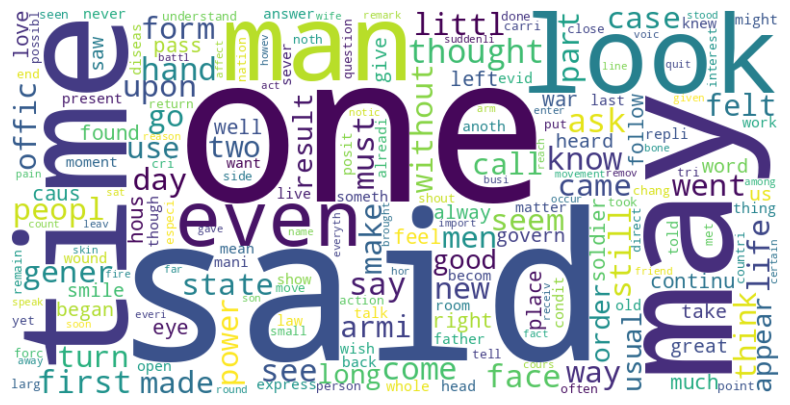

In [13]:
text = " ".join(stem_List)
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(text)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

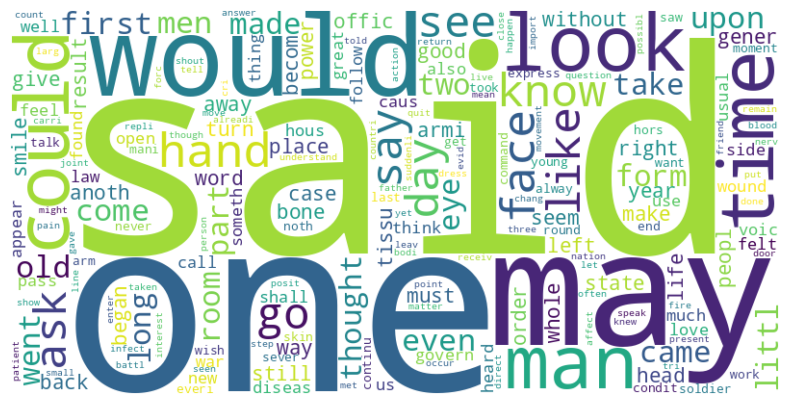

In [14]:
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(fdist)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis("off")
plt.show()

<h2>Task 2 - Audio Data PreProcessing</h2>

In [15]:
import librosa
import numpy as np

•	Load the audio file from the provided URL using an audio processing library such as librosa or scipy.

In [17]:
url = 'two.wav'
y, sr = librosa.load(url)

•	Normalize the audio signal so that its amplitude lies within a consistent range (typically between -1 and 1) to improve processing stability.

In [18]:
max_y = np.max(np.abs(y))

normalized_y = y / max_y

print(f"Original array: {y}")
print(f"Normalized array: {normalized_y}")

Original array: [-0.04229989 -0.04891741 -0.0376581  ... -0.00187707  0.00271878
  0.00249752]
Normalized array: [-0.13377197 -0.15469967 -0.11909247 ... -0.00593617  0.00859806
  0.00789832]


•	Visualize the audio waveform to understand the time-domain representation of the signal. You can use libraries like matplotlib for plotting.

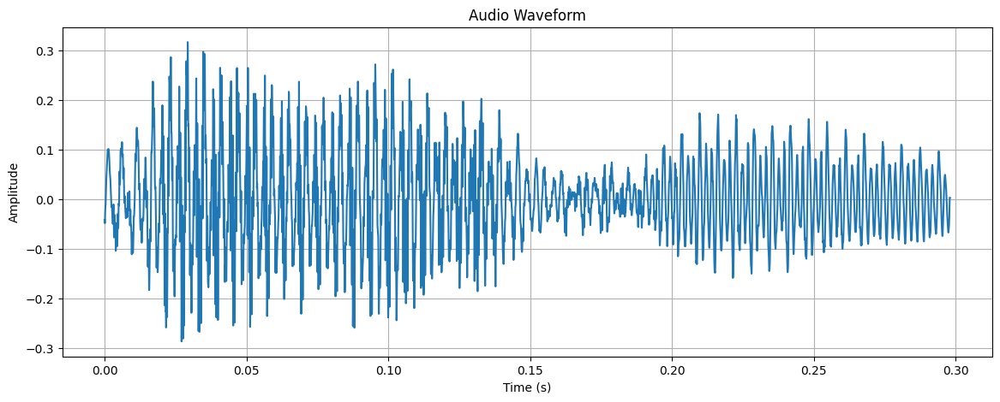

In [19]:
time = np.linspace(0, len(y) / sr, num=len(y))

plt.figure(figsize=(14, 5))
plt.plot(time, y)
plt.title('Audio Waveform')
plt.xlabel('Time (s)')
plt.ylabel('Amplitude')
plt.grid(True)
plt.show()

•	Extract MFCC (Mel Frequency Cepstral Coefficients) features from the audio. MFCCs are commonly used in audio and speech recognition tasks as they represent the short-term power spectrum of sound.

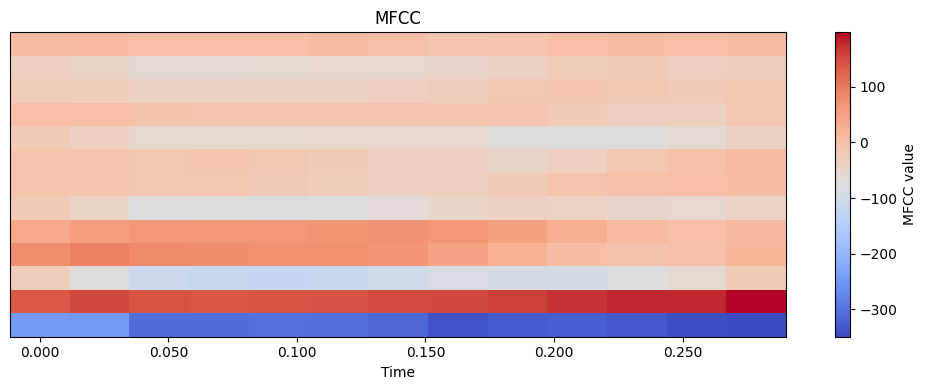

In [20]:
mfccs = librosa.feature.mfcc(y=y, sr=sr, n_mfcc=13)
import librosa.display
plt.figure(figsize=(10, 4))
librosa.display.specshow(mfccs, x_axis='time')
plt.colorbar(label='MFCC value')
plt.title('MFCC')
plt.tight_layout()
plt.show()

<h2>Task 3 - Video Data PreProcessing</h2>

In [21]:
import cv2
from google.colab.patches import cv2_imshow

•	Load the video from the given URL into your Python environment using a video processing library like OpenCV.

In [22]:
cap = cv2.VideoCapture("billo.mp4")

•	Read the video frame by frame using a loop and store each frame for further processing.
<br>
•	For every extracted frame, convert it from RGB (color) to grayscale using OpenCV functions.
<br>
•	Resize each grayscale frame to a fixed size (e.g., 128×128 pixels) to maintain uniformity for analysis or model input

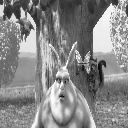

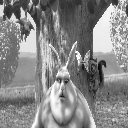

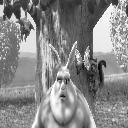

In [23]:
if not cap.isOpened():
    print("Error: Could not open video stream or file")

mFr = 3
fr = 0
while fr < mFr:
    ret, frame = cap.read()
    if not ret:
        break

    gray_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)
    resized_frame = cv2.resize(gray_frame, (128, 128))
    cv2_imshow(resized_frame)
    fr = fr+1

cap.release()
cv2.destroyAllWindows()